In [1]:
import numpy as np
import os
import h5py

In [2]:
import torch
import torch.nn            as nn
import torch.nn.functional as F

In [3]:
from peaknet.app     import PeakFinder
from peaknet.plugins import CheetahConverter, PsanaImg, apply_mask

In [4]:
import cupy as cp

In [5]:
from skimage import measure
from PIL import Image

In [6]:
import json

In [7]:
import matplotlib.pyplot as plt
import matplotlib.colors       as mcolors
import matplotlib.patches      as mpatches
import matplotlib.transforms   as mtransforms
%matplotlib inline

In [8]:
path_cxi = "inference_results/peaknet.cxic00318_0123.cxi"

try:
    fh.close()
except:
    pass

fh = h5py.File(path_cxi, "r")

In [9]:
path_chkpt = "experiments/chkpts/opt_cxi.00.2023_1108_2307_12.epoch_96.chkpt"
path_yaml = "experiments/yaml/opt_cxi.00.yaml"
pf = PeakFinder(path_chkpt = path_chkpt, path_cheetah_geom = None, path_yaml_config = path_yaml)

device = pf.device

Compiling the model...
Done compiling the model...


In [10]:
path_geom = "cheetah_geom.jungfrau.pickle"
cheetah_converter = CheetahConverter(path_geom)

In [11]:
idx = 0
img = fh.get('entry_1/data_1/data')[idx:idx+4]

In [20]:
img.shape

(4, 4096, 1024)

In [18]:
img_tensor.shape

torch.Size([4, 1, 4096, 1024])

In [13]:
img_tensor = torch.tensor(img[:, None,]).to(device)
batch_ndimage_labels = pf.generate_ndimage_labels(img_tensor)

In [19]:
batch_ndimage_labels

[[array([[0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         ...,
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0]], dtype=int32),
  78],
 [array([[0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         ...,
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0]], dtype=int32),
  6],
 [array([[0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         ...,
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0]], dtype=int32),
  4],
 [array([[0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         ...,
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0]], dtype=int32),
  5]]

In [27]:
drc_root = 'data_root/pf/'
coco_dict = {
    "images" : [],
    "annotations" : [],
    "categories" : [
        {
            "id": 1,
            "name": "peak"
        },
        {
            "id": 2,
            "name": "artifact scattering"
        },
        {
            "id": 3,
            "name": "bad pixel"
        },
    ],
}
for enum_idx, (ndimage_label, num_peaks) in enumerate(batch_ndimage_labels):
    contours = measure.find_contours(cp.asnumpy(ndimage_label > 0))

    # Convert contours to COCO format
    coco_polygons = []
    for contour in contours:
        # Flatten the contour array and round off the values
        contour = np.around(contour).astype(int).flatten().tolist()
        coco_polygons.append(contour)

    # Create a COCO annotation
    coco_annotation = {
        "segmentation": coco_polygons,
        "area": 0, # calculate the area of the polygon if needed
        "iscrowd": 0, # 0 or 1 depending on your data
        "image_id": enum_idx, # ID of the image this annotation belongs to
        "category_id": 1, # ID of the category this annotation belongs to
        "id": enum_idx # ID of this annotation
    }

    file_img = f"demo_{enum_idx:06d}.png"
    rel_path_img = os.path.join("label_studio", file_img)
    path_img = os.path.join(drc_root, rel_path_img)

    H, W = ndimage_label.shape
    coco_dict["images"].append(
            {
                "file_name": path_img,
                "id": enum_idx,
                "width": W,
                "height": H,
            },
    )
    coco_dict["annotations"].append(
        coco_annotation
    )

    # Export to png...
    data = img[enum_idx]

    # Apply a colormap using Matplotlib
    cmap = plt.cm.viridis  # Replace with any other colormap you like

    # Calculate the dynamic range clipping
    sigma_cut = 1
    vmin = np.mean(data) - 0 * data.std()
    vmax = np.mean(data) + sigma_cut * data.std()

    # Clip the values and normalize between 0 and 1
    data = np.clip(data, vmin, vmax)

    # Normalize the image data
    norm = plt.Normalize(vmin=data.min(), vmax=data.max())
    data_normalized = norm(data)

    # Apply the colormap
    colored_data = cmap(data_normalized)

    # Convert to an image
    colored_data = (colored_data[:, :, :3] * 255).astype(np.uint8)  # Discard the alpha channel and convert to 8-bit array
    img_pil = Image.fromarray(colored_data)

    # Save the image with PIL
    img_pil.save(rel_path_img)



In [25]:
# Writing the COCO data to a JSON file
with open('coco_annotations.json', 'w') as f:
    json.dump(coco_dict, f)

In [24]:
ndimage_label > 0

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [25]:
type(cp.asnumpy(ndimage_label > 0))

numpy.ndarray

In [26]:
contours = measure.find_contours(cp.asnumpy(ndimage_label > 0))

In [38]:
# Convert contours to COCO format
coco_polygons = []
for contour in contours:
    # Flatten the contour array and round off the values
    contour = np.around(contour).astype(int).flatten().tolist()
    coco_polygons.append(contour)

# Create a COCO annotation
coco_annotation = {
    "segmentation": coco_polygons,
    "area": 0, # calculate the area of the polygon if needed
    "iscrowd": 0, # 0 or 1 depending on your data
    "image_id": 1, # ID of the image this annotation belongs to
    "category_id": 1, # ID of the category this annotation belongs to
    "id": 1 # ID of this annotation
}

In [40]:
H, W = img.shape
# Example structure. You'll need to populate these with your actual data.
data = {
    "images": [
        {
            "file_name": "data_root/pf/label_studio/image1.png",
            "id": 1,
            "width": W,
            "height": H,
        },
        # ... more images
    ],
    "annotations": [
        coco_annotation,
        # ... more annotations
    ],
    "categories": [
        {
            "id": 1,
            "name": "peak"
        },
        {
            "id": 2,
            "name": "artifact scattering"
        },
        {
            "id": 3,
            "name": "bad pixel"
        },
        # ... more categories
    ]
}

# Writing the COCO data to a JSON file
with open('coco_annotations.json', 'w') as f:
    json.dump(data, f)

In [ ]:
contours

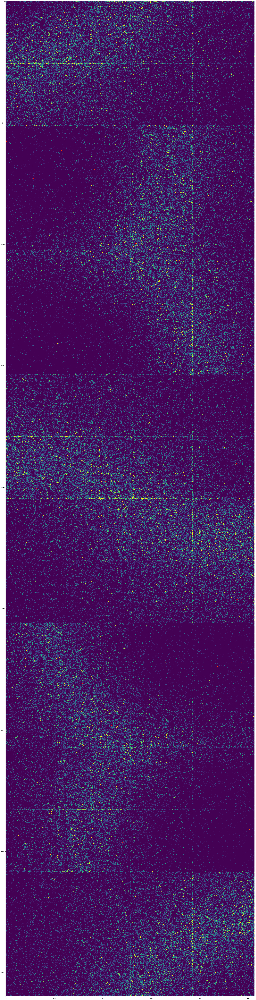

In [32]:
offset = 4
b_offset = 2
size_y, size_x = img.shape[-2:]
y_bmin, x_bmin = 0, 0
y_bmax, x_bmax = size_y, size_x

scale = 4

# [[[ Visual ]]]
# Set up the visual
ncols = 1
nrows = 1
fig   = plt.figure(figsize = (16*scale,32*scale))
gspec = fig.add_gridspec( nrows, ncols,
                          width_ratios  = [1],
                          height_ratios = [1,], 
                        )
ax_list = [ fig.add_subplot(gspec[0, 0], aspect = 1),  ]

ax = ax_list[0]

# Plot image
data = img
vmin = np.mean(data) - 0 * data.std()
vmax = np.mean(data) + 4 * data.std()
im = ax.imshow(data, vmin = vmin, vmax = vmax)
# im = ax_list[0].imshow(data, vmin = 0, vmax = 0.2)
# im.set_clim(vmin, vmax)
ax.set_xlim([x_bmin - b_offset, x_bmax + b_offset])
ax.set_ylim([y_bmin - b_offset, y_bmax + b_offset])
ax.invert_yaxis()

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=1, color = 'red')

In [19]:
idx = 0
img = fh.get('entry_1/data_1/data')[idx]

# Apply a colormap using Matplotlib
cmap = plt.cm.viridis  # Replace with any other colormap you like

# Calculate the dynamic range clipping
sigma_cut = 1
vmin = np.mean(img) - 0 * img.std()
vmax = np.mean(img) + sigma_cut * img.std()

# Clip the values and normalize between 0 and 1
img = np.clip(img, vmin, vmax)

# Normalize the image data
norm = plt.Normalize(vmin=img.min(), vmax=img.max())
image_data_normalized = norm(img)

# Apply the colormap
colored_image_data = cmap(image_data_normalized)

# Convert to an image
colored_image_data = (colored_image_data[:, :, :3] * 255).astype(np.uint8)  # Discard the alpha channel and convert to 8-bit array
img_pil = Image.fromarray(colored_image_data)

# Save the image with PIL
img_pil.save('label_studio/image1.png')

In [43]:
img_pil.size

(1024, 4096)

In [34]:
fig.savefig("label_studio/image1.png", dpi = 300)